In [1]:
#Required packages
# pip3 install tensorflow pillow matplotlib numpy scikit-image scikit-learn xgboost seaborn joblib ipykernel

###
# Machine learning libraries
###

# TensorFlow: An open-source platform for machine learning, used here for feature extraction with ResNet
# URL: https://www.tensorflow.org/
#note: if having issues with tensorflow, try changing your python kernel to another kind
import tensorflow as tf
from tensorflow.keras.applications import ResNet50  # Pre-trained ResNet50 model for feature extraction
from tensorflow.keras.preprocessing import image  # Utilities for image preprocessing
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions  # Functions for preprocessing input and decoding predictions

# Scikit-learn: A machine learning library for Python, used here for data preprocessing and evaluation
# URL: https://scikit-learn.org/
from sklearn.model_selection import train_test_split  # For splitting data into training and testing sets
from sklearn.preprocessing import LabelEncoder  # For encoding labels as integers
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, f1_score, recall_score  # For evaluating model performance
from sklearn.model_selection import cross_val_score, StratifiedKFold

# Scikit-image: A collection of algorithms for image processing
# URL: https://scikit-image.org/
from skimage import io  # For reading and writing images
from skimage.segmentation import slic, mark_boundaries  # For segmenting images and marking boundaries
from skimage.util import img_as_float  # For converting images to floating point format
from skimage.measure import regionprops  # For measuring properties of labeled image regions


# XGBoost: An optimized distributed gradient boosting library, used here for building the classification model
# URL: https://xgboost.readthedocs.io/
from xgboost import XGBClassifier
import xgboost as xgb

###
# Data visualization libraries
### 

# Matplotlib: A plotting library for creating static, animated, and interactive visualizations
# URL: https://matplotlib.org/
import matplotlib.pyplot as plt

# Seaborn: A Python visualization library based on matplotlib, used here for statistical data visualization
# URL: https://seaborn.pydata.org/
import seaborn as sns


###
# Other useful stuff
###
# Pandas: A fast, powerful, flexible, and easy-to-use open-source data analysis and data manipulation library
# URL: https://pandas.pydata.org/
import pandas as pd

# NumPy: A fundamental package for scientific computing with Python, used here for handling arrays
# URL: https://numpy.org/
import numpy as np

# PIL (Pillow): Python Imaging Library for opening, manipulating, and saving images
# URL: https://pillow.readthedocs.io/
from PIL import Image

# SciPy: A Python library used for scientific and technical computing
# URL: https://www.scipy.org/
from scipy import misc, ndimage  # For miscellaneous image processing tasks and multi-dimensional image processing

# Joblib: A set of tools to provide lightweight pipelining in Python, used here for saving and loading models
# URL: https://joblib.readthedocs.io/
import joblib

# OS: A module providing a way of using operating system dependent functionality
# URL: https://docs.python.org/3/library/os.html
import os
from os import listdir  # For listing directory contents
from os.path import isfile, join  # For file path manipulations



## Step 1. Preview and load images

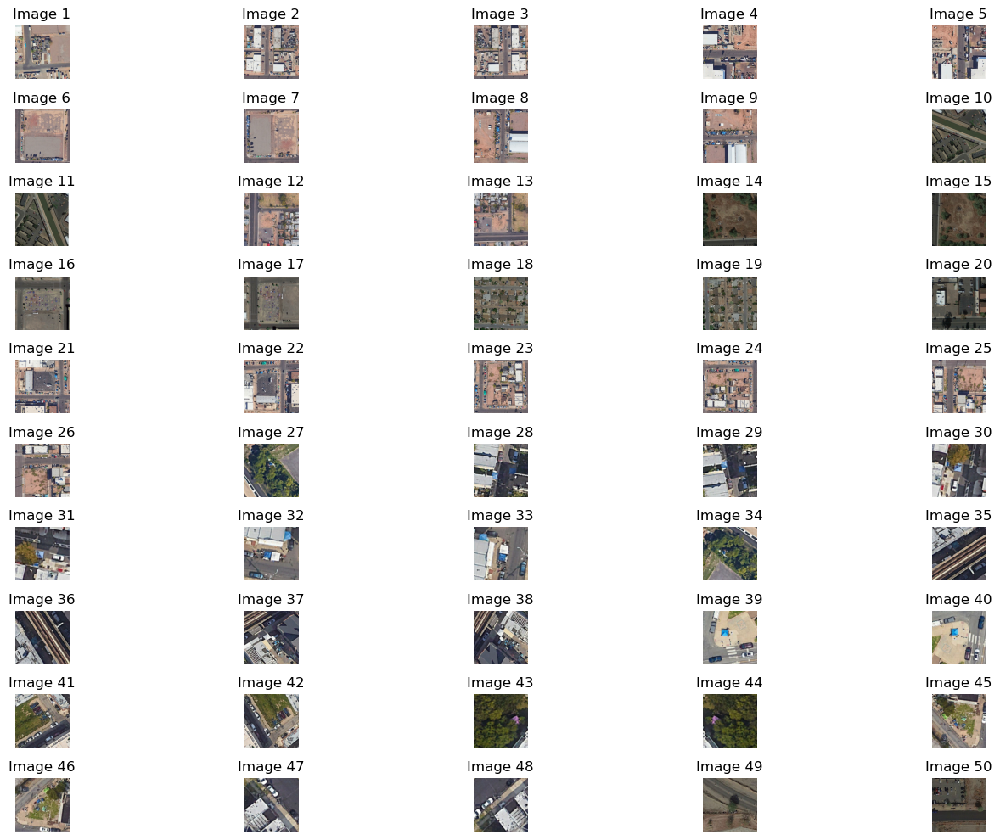

In [2]:
# Tell model where positive images are located (images with homeless encampments identified)
positive_img_path =  "./model/datasets/positive_tiles/"  

# Get the list of image files from positive_tiles folder
image_files = sorted([f for f in listdir(positive_img_path) if isfile(join(positive_img_path, f))])

# Select the first 50 images (setting to 50 for now hoping we will be able to add more)
image_files = image_files[:50]

# Create a grid to display the images - make space for 10 rows of 5 images each
fig, axes = plt.subplots(10, 5, figsize=(15, 10))

# Iterate over the axes and image files to display each image on a grid
for i, ax in enumerate(axes.flat):
    if i < len(image_files):
        img = Image.open(join(positive_img_path, image_files[i]))
        ax.imshow(img)
        ax.set_title(f"Image {i+1}")
    ax.axis('off')

plt.tight_layout()
plt.show()

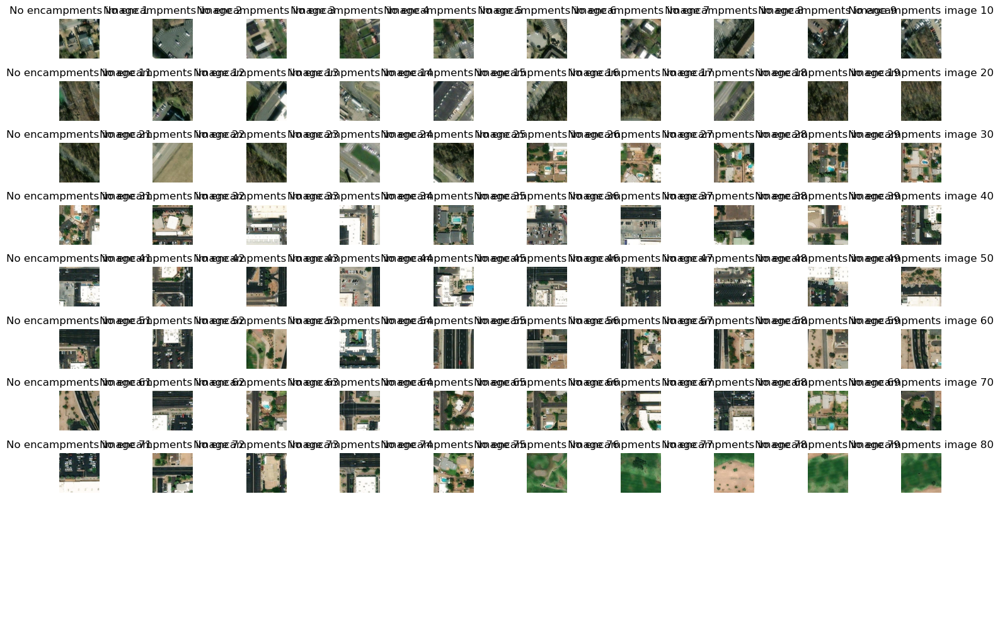

In [3]:

# where to find negative images with no encampments
negative_img_path =  "./model/datasets/negative_tiles/"  

# Get the list of image files in the negative examples folder
image_files = sorted([f for f in listdir(negative_img_path) if isfile(join(negative_img_path, f))])

# Select the first 50 images (hopefully we will be able to add more)
image_files = image_files[:100]

# Create a grid to display the images
fig, axes = plt.subplots(10, 10, figsize=(15, 10))

# Iterate over the axes and image files to display each image on a grid
for i, ax in enumerate(axes.flat):
    if i < len(image_files):
        img = Image.open(join(negative_img_path, image_files[i]))
        ax.imshow(img)
        ax.set_title(f"No encampments image {i+1}")
    ax.axis('off')

plt.tight_layout()
plt.show()

## Step 2. Extract features from our positive and negative images

In [4]:
#load resnet - pretrained model that extracts features from images 
resnet = ResNet50(weights='imagenet', include_top=False, pooling='avg')

### Use ResNet50 to extract features from our images

In [5]:
# where to find positive images
positive_img_path =  "./model/datasets/positive_tiles/"  

# Get the list of image files in the positive_tiles folder
image_files = sorted([f for f in listdir(positive_img_path) if isfile(join(positive_img_path, f))])

# where to find positive examples (images with encampment extraction footprints ) 
negative_img_path =  "./model/datasets/negative_tiles/"  

# Get the list of image files in the negative examples folder
image_files = sorted([f for f in listdir(negative_img_path) if isfile(join(negative_img_path, f))])

In [6]:
###
# Define function to use ResNet50 to extract information from images
###

def extract_features(img_paths, batch_size=64):
    """ 
    This function extracts image features for each image in img_paths using the ResNet50 penultimate layer.
    Returned features is a numpy array with shape (len(img_paths), 2048).
    """
    global resnet
    n = len(img_paths)  # Number of images in img_paths
    img_array = np.zeros((n, 224, 224, 3))  # Initialize an array to hold the images
    
    for i, path in enumerate(img_paths):
        img = image.load_img(path, target_size=(224, 224))  # Load and resize each image to 224x224
        img = image.img_to_array(img)  # Convert image to array
        img = preprocess_input(img)  # Preprocess the image for ResNet50
        img_array[i] = img  # Add the image to the array
    
    resnet_predictions = resnet.predict(img_array, batch_size=batch_size, verbose=1)  # Extract features using ResNet50
    return resnet_predictions # Return the extracted features

###
# Get a list of training images to process
###

# Define paths to positive and negative image directories
positive_img_path = "./model/datasets/positive_tiles/"  # Directory for positive examples (images with encampment extraction footprints)
negative_img_path = "./model/datasets/negative_tiles/"  # Directory for negative examples

# List all image files in the positive and negative directories
positive_files = [join(positive_img_path, f) for f in listdir(positive_img_path) if isfile(join(positive_img_path, f))]
negative_files = [join(negative_img_path, f) for f in listdir(negative_img_path) if isfile(join(negative_img_path, f))]

# Extract features for positive and negative images
positives_ = extract_features(positive_files)
negatives_ = extract_features(negative_files)

###
# Define function to make a dataframe with ResNet50 results
###

def create_df(feature_vectors, label, img_paths):
    """ 
    Create a pandas DataFrame. Each row in the DataFrame consists of features, label, and path to the corresponding image.
    """
    feat_cols = ['feature' + str(i) for i in range(feature_vectors.shape[1])]  # Column names for elements of feature vector
    df = pd.DataFrame(feature_vectors, columns=feat_cols)  # Create DataFrame with feature vectors
    df['label'] = label  # Add column with labels
    df['path'] = img_paths  # Add column with image paths
    return df

###
# Create the dataframes by running the funcitons
###

# Create DataFrames for positive and negative features
df1 = create_df(positives_, "positive", positive_files)
df2 = create_df(negatives_, "negative", negative_files)

# Concatenate the DataFrames
df = pd.concat([df1, df2], ignore_index=True)
print('Size of the dataframe: {}'.format(df.shape))  # Print the size of the DataFrame

# Save the DataFrame to a CSV file for later use
df.to_csv("features_backup.csv", index=False)

# Display the dataframe
df

2/2 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 444ms/step
Size of the dataframe: (164, 2050)


,feature0,feature1,feature2,feature3,feature4,feature5,feature6,feature7,feature8,feature9,...,feature2040,feature2041,feature2042,feature2043,feature2044,feature2045,feature2046,feature2047,label,path
0,0.020472,1.822806,0.113020,0.915267,0.000000,0.317929,0.409238,0.069624,1.575805,0.001375,...,0.124841,0.032105,0.118757,0.056443,0.051035,0.845488,0.189552,0.058271,positive,./model/datasets/positive_tiles/is_encampment_...
1,0.097720,0.391664,0.278897,3.088290,0.186953,1.169025,0.141327,0.000000,6.655890,0.227430,...,0.837761,0.011703,0.321346,0.201056,2.486517,0.634914,0.466220,0.094776,positive,./model/datasets/positive_tiles/is_encampment_...
2,0.086429,0.345198,0.551238,0.303495,0.051707,0.217155,0.387211,0.139612,2.880727,0.097128,...,0.198028,0.142560,0.665787,0.025880,0.238467,0.027767,0.078680,0.525439,positive,./model/datasets/positive_tiles/is_encampment_...
3,0.363271,0.622822,0.169734,1.014597,0.258708,0.568336,0.011858,0.055709,5.242737,0.531424,...,0.341543,0.011118,0.106814,0.021297,2.620627,0.166616,0.176217,0.233096,positive,./model/datasets/positive_tiles/is_encampment_...
4,0.049416,0.302358,0.345757,1.137427,0.018011,0.124805,0.120917,0.007670,3.012325,0.001560,...,0.095032,0.000000,0.804507,0.000000,1.166517,0.000000,0.115031,1.046092,positive,./model/datasets/positive_tiles/is_encampment_...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159,0.618948,1.139978,0.408783,0.028156,0.460599,0.016080,0.112787,0.394623,0.000000,0.021502,...,5.102095,0.142227,0.685212,1.950727,0.030076,0.000000,0.345459,0.927093,negative,./model/datasets/negative_tiles/tile_19_152872...
160,0.029940,0.263283,0.000000,0.000000,0.000000,0.000000,0.122929,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.196681,0.000000,0.000000,negative,./model/datasets/negative_tiles/tile_19_152878...
161,0.001266,1.415713,1.891128,0.866594,0.044552,0.000000,0.909271,0.381291,0.548635,0.040686,...,0.054756,0.076191,0.425192,0.000000,0.881637,0.291571,0.666142,0.040695,negative,./model/datasets/negative_tiles/tile_19_98969_...
162,0.012839,1.461127,3.013891,1.975997,0.002513,0.092753,0.124668,0.231123,1.270805,0.722921,...,0.517814,0.000000,0.149041,0.105466,0.044026,0.414865,0.497024,0.248965,negative,./model/datasets/negative_tiles/tile_19_98969_...


## 3. Train the model

### 4a. Create training set and test set of images

We now split our data into both a "training set" -- which we'll use to train the model -- and the "test set", a different group of images our model has not seen that we'll use to test its performance. 

In [7]:
###
# Split the Data into Training and Testing Sets
###

# Extract numeric feature values for each image (first 2048 columns)
X = df.iloc[:, 0:2048].values

# Extract labels for each image (2048th column)
Y = df.iloc[:, 2048].values

# Extract paths to image files
tiles = df["path"].values

# Split the data into training and testing sets
# 70% of the data will be used for training, and 30% for testing
# random_state ensures reproducibility of the split
X_train, X_test, Y_train, Y_test, tiles_train, tiles_test = train_test_split(X, Y, tiles, test_size=0.3, random_state=43)

# Encode the labels as integers
# This is necessary for training the machine learning model
label_encoder = LabelEncoder()
Y_train_encoded = label_encoder.fit_transform(Y_train)  # Fit and transform labels for the training set
Y_test_encoded = label_encoder.transform(Y_test)        # Transform labels for the testing set

### 4b. Train our model using XGBoost classifier

Now, we'll use our training data to train our classification model.  


In [8]:
###
# Define our XGBoost classifier
###

# Initialize the XGBoost classifier with specific hyperparameters and store it as clf for later use.
#Did some tweaking to the XGBoost classifier to adjust for our smaller dataset based on feedback from Claude 
# - ultimately once I got to reducing the minimum child weight, I was able to get the model to 100 percent accuracy

clf = XGBClassifier(
    learning_rate=0.005,  # Step size shrinkage used to prevent overfitting. Range: [0,.005]
    #changed this to 0.005 from 0.01 because our dataset is small
    n_estimators=1000,  # Number of gradient boosted trees. Large value can lead to overfitting.
    #dropped this from 5000 to 1000 because it's better for a smaller dataset - dropped further to 500 after implementing early stopping
    max_depth=2,  # Maximum depth of a tree. Increasing this value makes the model more complex and more likely to overfit.
    #Reduced to 3 to reduce false positives, prevent memorizing training data? - dropped to 2 after adding more data to handle false negatives
    min_child_weight=4,  # Minimum sum of instance weight (hessian) needed in a child. Used to control overfitting.
    #dropped from 6 to allow learning from smaller groups ASK CLAUDE ABOUT THIS
    gamma=0.2,  # Minimum loss reduction required to make a further partition on a leaf node. The larger, the more conservative the algorithm will be.
    #bumped up to 0.2 to help with false positives - 
    subsample=0.8,  # Subsample ratio of the training instances. Prevents overfitting by sampling X% of the training data.
    colsample_bytree=0.8,  # Subsample ratio of columns when constructing each tree. Prevents overfitting by sampling X% of the features.
    reg_alpha=0.01,  # L1 regularization term on weights. Increasing this value makes the model more conservative.
    #bumed to .01 ASK CLAUDE ABOUT THIS
    objective='binary:logistic',  # Specifies the learning task and the corresponding learning objective. Here, it's binary classification.
    nthread=7,  # Number of parallel threads used to run XGBoost. Adjust based on your system's capabilities.
    scale_pos_weight=1.8,  # Balancing of positive and negative weights. Useful for unbalanced classes.
    #changed this to account for the higher number of negative examples in our dataset
    seed=27  # Random seed for reproducibility.
)

###
# Fit the XGBoost classifier to the training data aka build the model
###

# X_train: Training features
# Y_train_encoded: Encoded training labels
#old code: clf.fit(X_train, Y_train_encoded)
# Splitting some data off for validation - this is part of implementing early stopping.
#We use the validation set to figure out when to stop the model 
from sklearn.model_selection import train_test_split
X_train_inner, X_val, y_train_inner, y_val = train_test_split(X_train, Y_train_encoded, test_size=0.20, random_state=27)
#dropped test size to .2 then .15, ask claude why
#dropping test size to .15 resulted in worse results, so we tried bumping it up to .25 - also didn't work so returned to .2
# Fit the model with early stopping - this basically stops the model when it's not improving anymore
clf.fit(
    X_train_inner, 
    y_train_inner,
    eval_set=[(X_val, y_val)],  # Only using validation set for evaluation - first version of early_stopping didn't run
    verbose=True
)

# Save the model using XGBoost's Booster class
booster = clf.get_booster()
booster.save_model('model/versions/xgb_model.json')


[0]	validation_0-logloss:0.71715
[1]	validation_0-logloss:0.71545
[2]	validation_0-logloss:0.71380
[3]	validation_0-logloss:0.71113
[4]	validation_0-logloss:0.70864
[5]	validation_0-logloss:0.70562
[6]	validation_0-logloss:0.70404
[7]	validation_0-logloss:0.70215
[8]	validation_0-logloss:0.70108
[9]	validation_0-logloss:0.69934
[10]	validation_0-logloss:0.69651
[11]	validation_0-logloss:0.69438
[12]	validation_0-logloss:0.69295
[13]	validation_0-logloss:0.69124
[14]	validation_0-logloss:0.69015
[15]	validation_0-logloss:0.68890
[16]	validation_0-logloss:0.68718
[17]	validation_0-logloss:0.68600
[18]	validation_0-logloss:0.68468
[19]	validation_0-logloss:0.68436
[20]	validation_0-logloss:0.68363
[21]	validation_0-logloss:0.68307
[22]	validation_0-logloss:0.68148
[23]	validation_0-logloss:0.68031
[24]	validation_0-logloss:0.67884
[25]	validation_0-logloss:0.67686
[26]	validation_0-logloss:0.67610
[27]	validation_0-logloss:0.67462
[28]	validation_0-logloss:0.67391
[29]	validation_0-loglos

Now let's add in some cross-validation to see how well our model is doing across multiple iterations.

In [9]:
# Create the cross validator
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=27)

# Perform cross-validation
scores = cross_val_score(clf, X_train, Y_train_encoded, cv=cv, scoring='accuracy')
precision_scores = cross_val_score(clf, X_train, Y_train_encoded, cv=cv, scoring='precision')

# Print the results
print("Cross-validation Results:")
print(f"Accuracy scores: {scores}")
print(f"Average accuracy: {scores.mean():.3f} (+/- {scores.std() * 2:.3f})")
print(f"\nPrecision scores: {precision_scores}")
print(f"Average precision: {precision_scores.mean():.3f} (+/- {precision_scores.std() * 2:.3f})")

Cross-validation Results:
Accuracy scores: [0.95652174 1.         0.91304348 0.86956522 0.95454545]
Average accuracy: 0.939 (+/- 0.088)

Precision scores: [0.91666667 1.         0.91666667 0.84615385 0.91666667]
Average precision: 0.919 (+/- 0.098)


## 5. Evaluate the model

Now that we've trained our model, it's time to evaluate its performance.  We will:

* Review a "confusion matrix" to get an overview of perfomrance. 
* Review some assessment metrics: precision, recall, accuracy, fscore.
* Look closely at images it classified correctly and incorrectly.


First let's try running our model on our merged photos.

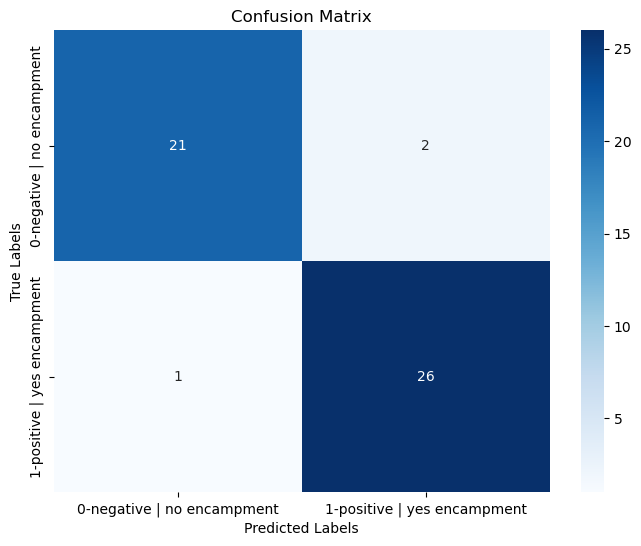

MODEL METRICS
_________
Precision: 0.9286
Recall: 0.9630
F1-Score: 0.9455
Accuracy: 0.9400


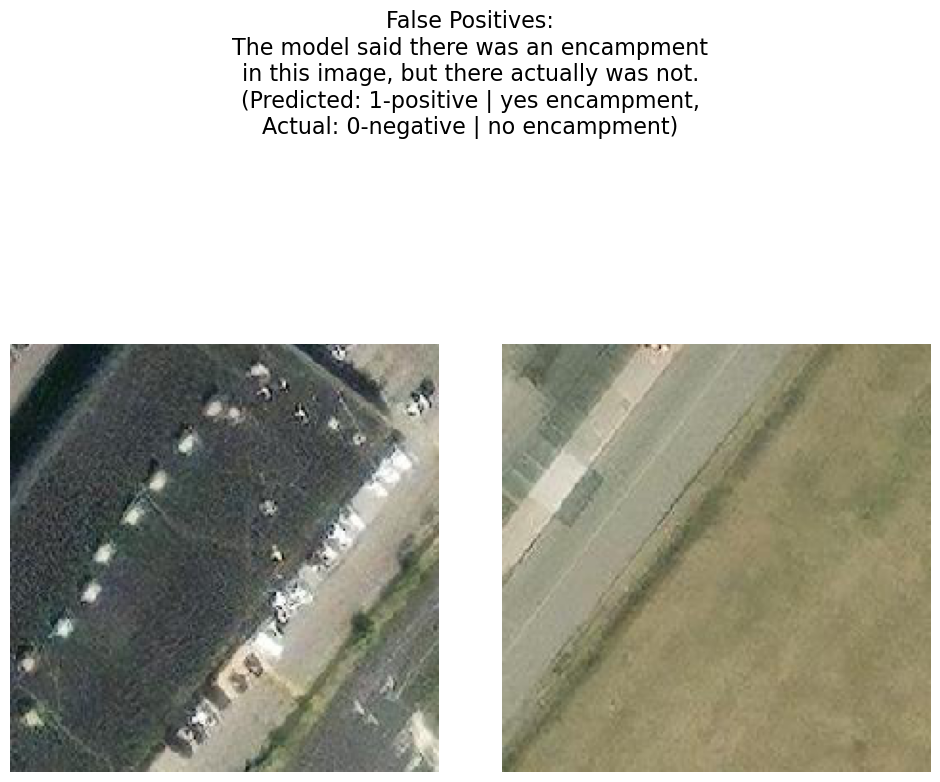

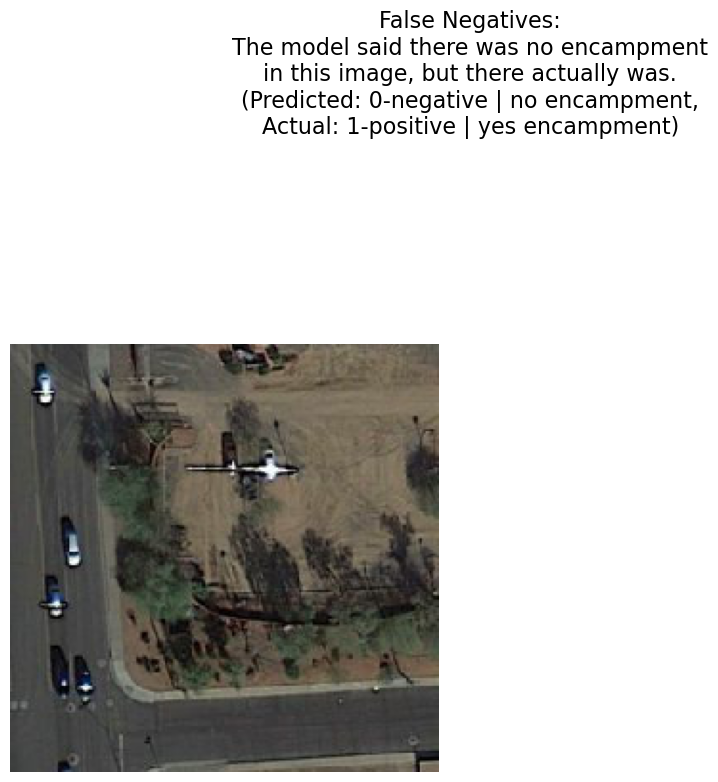

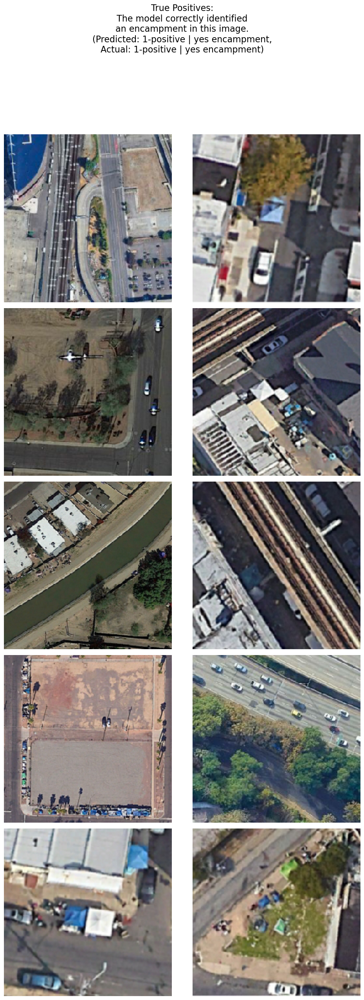

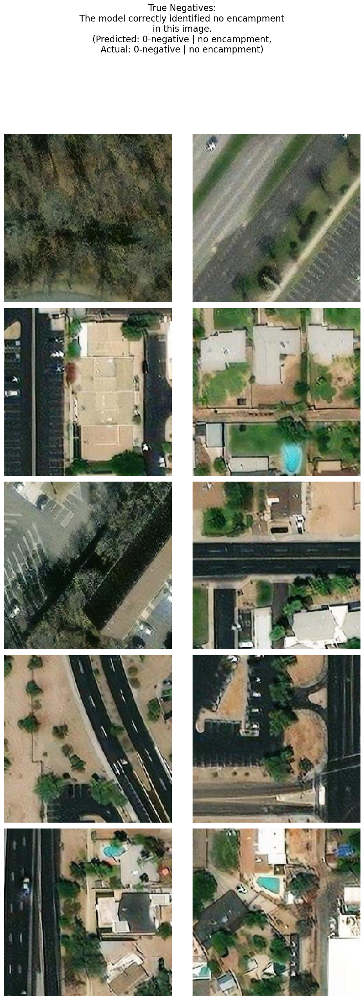

In [10]:
###
# Function to output evaluation information
###

def evaluate(y_true, y_pred, image_paths):

    ###
    # Output a confusion matrix
    ###

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    
    # Create a heatmap for the confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=['0-negative | no encampment', '1-positive | yes encampment'], 
                yticklabels=['0-negative | no encampment', '1-positive | yes encampment'])
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()
    
    ###
    # Output statistics
    ###

    # Print precision, recall, F1-score, and accuracy

    # Calculate the precision of the predictions
    # Precision is the ratio of correctly predicted positive observations to the total predicted positives
    # It is a measure of the accuracy of the positive predictions
    precision = precision_score(y_true, y_pred, pos_label=1)

    # Calculate the recall of the predictions
    # Recall is the ratio of correctly predicted positive observations to all observations in the actual class
    # It is a measure of the ability of the model to find all the relevant cases within a dataset
    recall = recall_score(y_true, y_pred, pos_label=1)

    # Calculate the F1 score of the predictions
    # F1 score is the weighted average of Precision and Recall
    # It is useful when you need a balance between Precision and Recall
    f1 = f1_score(y_true, y_pred, pos_label=1)

    # Calculate the accuracy of the predictions
    # Accuracy is the ratio of correctly predicted observations to the total observations
    # It is the most intuitive performance measure and it is simply a ratio of correctly predicted observation to the total observations
    accuracy = accuracy_score(y_true, y_pred)
    
    # OPrint values

    print(f"MODEL METRICS")
    print(f"_________")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1-Score: {f1:.4f}")
    print(f"Accuracy: {accuracy:.4f}")
    
    ###
    # Output examples of correct and incorrect predicions
    ###

    # Identify the indices of false positives, false negatives, true positives, and true negatives
    false_positives = np.where((y_pred == 1) & (y_true == 0))[0]
    false_negatives = np.where((y_pred == 0) & (y_true == 1))[0]
    true_positives = np.where((y_pred == 1) & (y_true == 1))[0]
    true_negatives = np.where((y_pred == 0) & (y_true == 0))[0]
    
    # Extract image paths for each category
    fp_images = image_paths[false_positives]
    fn_images = image_paths[false_negatives]
    tp_images = image_paths[true_positives]
    tn_images = image_paths[true_negatives]
    
    # Display image grids with updated headings for each category
    display_image_grid(
        fp_images, 
        'False Positives:\nThe model said there was an encampment\nin this image, but there actually was not.\n(Predicted: 1-positive | yes encampment,\nActual: 0-negative | no encampment)'
    )
    display_image_grid(
        fn_images, 
        'False Negatives:\nThe model said there was no encampment\nin this image, but there actually was.\n(Predicted: 0-negative | no encampment,\nActual: 1-positive | yes encampment)'
    )
    display_image_grid(
        tp_images, 
        'True Positives:\nThe model correctly identified\nan encampment in this image.\n(Predicted: 1-positive | yes encampment,\nActual: 1-positive | yes encampment)'
    )
    display_image_grid(
        tn_images, 
        'True Negatives:\nThe model correctly identified no encampment\nin this image.\n(Predicted: 0-negative | no encampment,\nActual: 0-negative | no encampment)'
    )

###
# Function to display image grid
###

def display_image_grid(image_paths, title, num_images=10):
    """Display a grid of images from a list of image paths in a 2-column layout."""
    num_rows = (num_images + 1) // 2  # Calculate the number of rows needed for 2 columns
    plt.figure(figsize=(10, num_rows * 5))  # Adjust the figure size based on rows

    for i, img_path in enumerate(image_paths[:num_images]):
        img = image.load_img(img_path, target_size=(224, 224))  # Load image
        plt.subplot(num_rows, 2, i + 1)  # Arrange in a 2-column grid
        plt.imshow(img)
        plt.axis('off')  # Hide axes for a cleaner display

    # Ensure enough space between title and images
    plt.suptitle(title, fontsize=16, ha='center', va='top', y=1.02)  # Move the title higher
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to prevent overlap
    plt.show()

###
# Run evaluation function
###

# Make predictions on the test set
Y_pred = clf.predict(X_test)

# Evaluate the model and display the image grids with updated titles and proper spacing
evaluate(Y_test_encoded, Y_pred, tiles_test)


Looks like our model wasn't super successful despite a high accuracy rate. Let's try it on some tiles to see if we have better luck.

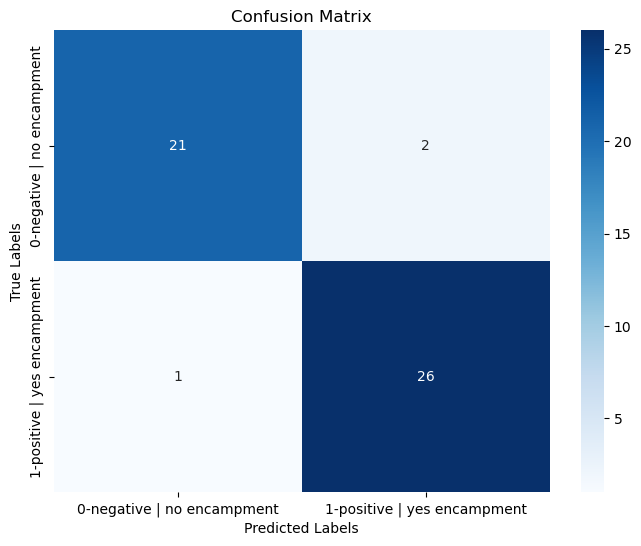

MODEL METRICS
_________
Precision: 0.9286
Recall: 0.9630
F1-Score: 0.9455
Accuracy: 0.9400


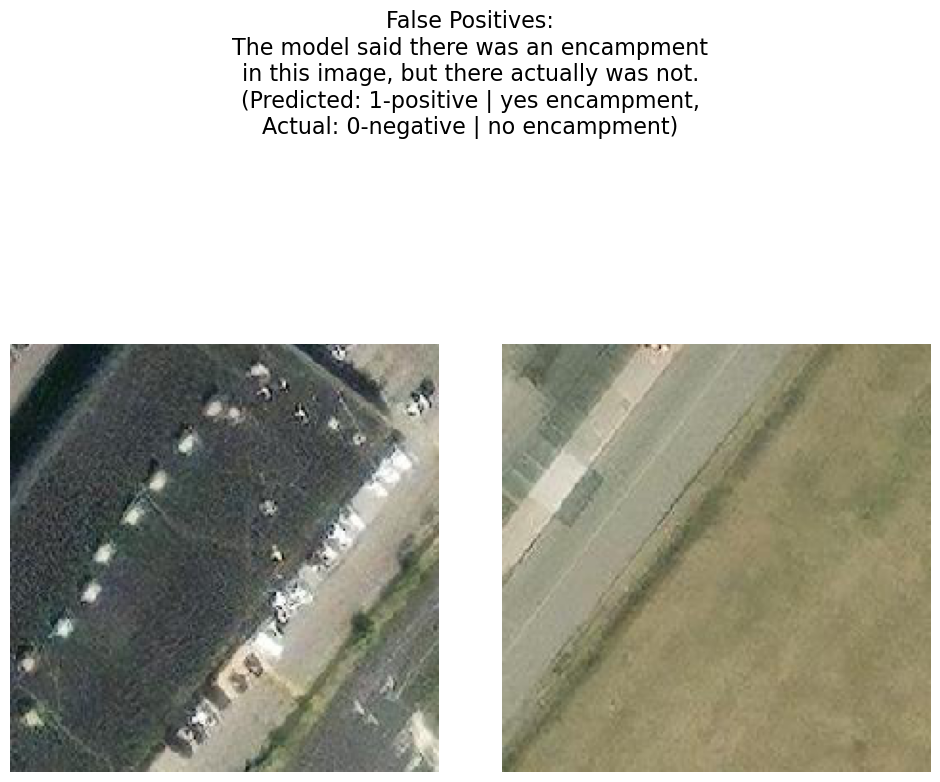

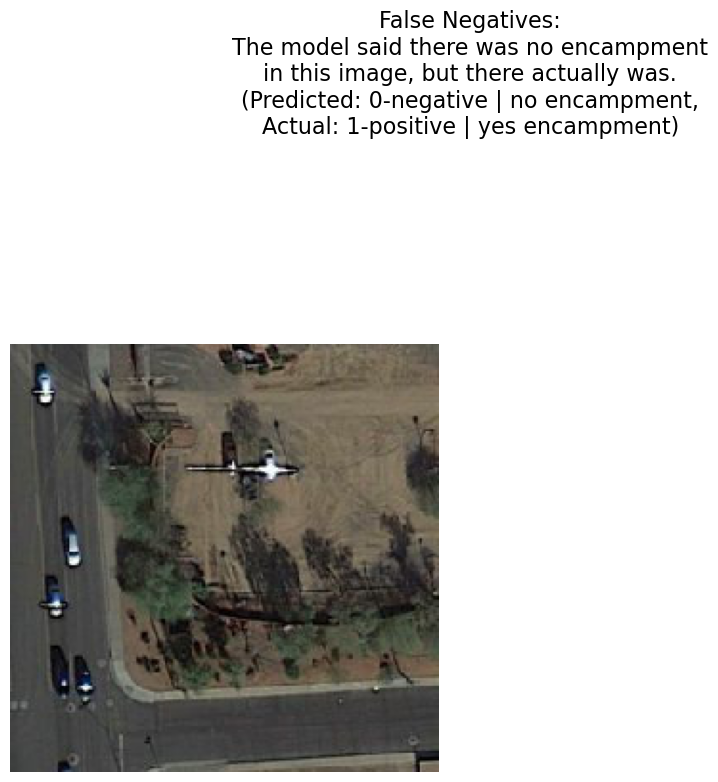

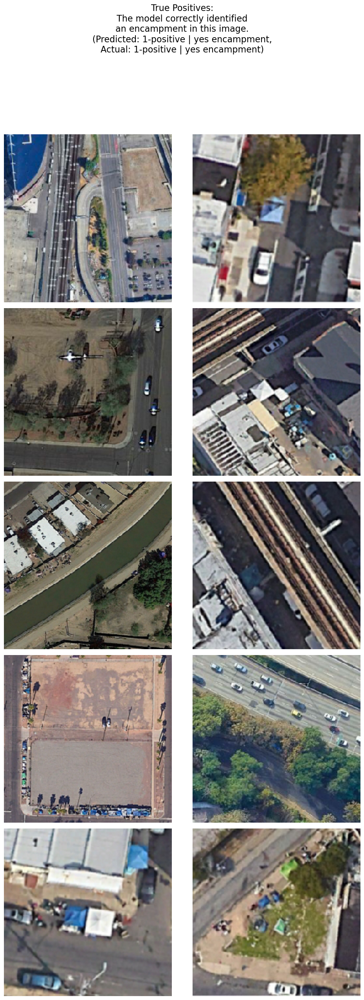

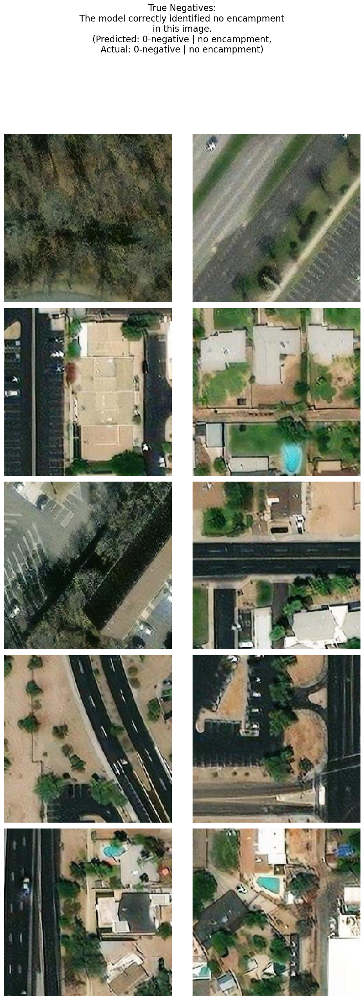

In [11]:
###
# Function to output evaluation information
###

def evaluate(y_true, y_pred, image_paths):

    ###
    # Output a confusion matrix
    ###

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    
    # Create a heatmap for the confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=['0-negative | no encampment', '1-positive | yes encampment'], 
                yticklabels=['0-negative | no encampment', '1-positive | yes encampment'])
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.title('Confusion Matrix')
    plt.show()
    
    ###
    # Output statistics
    ###

    # Print precision, recall, F1-score, and accuracy

    # Calculate the precision of the predictions
    # Precision is the ratio of correctly predicted positive observations to the total predicted positives
    # It is a measure of the accuracy of the positive predictions
    precision = precision_score(y_true, y_pred, pos_label=1)

    # Calculate the recall of the predictions
    # Recall is the ratio of correctly predicted positive observations to all observations in the actual class
    # It is a measure of the ability of the model to find all the relevant cases within a dataset
    recall = recall_score(y_true, y_pred, pos_label=1)

    # Calculate the F1 score of the predictions
    # F1 score is the weighted average of Precision and Recall
    # It is useful when you need a balance between Precision and Recall
    f1 = f1_score(y_true, y_pred, pos_label=1)

    # Calculate the accuracy of the predictions
    # Accuracy is the ratio of correctly predicted observations to the total observations
    # It is the most intuitive performance measure and it is simply a ratio of correctly predicted observation to the total observations
    accuracy = accuracy_score(y_true, y_pred)
    
    # OPrint values

    print(f"MODEL METRICS")
    print(f"_________")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1-Score: {f1:.4f}")
    print(f"Accuracy: {accuracy:.4f}")
    
    ###
    # Output examples of correct and incorrect predicions
    ###

    # Identify the indices of false positives, false negatives, true positives, and true negatives
    false_positives = np.where((y_pred == 1) & (y_true == 0))[0]
    false_negatives = np.where((y_pred == 0) & (y_true == 1))[0]
    true_positives = np.where((y_pred == 1) & (y_true == 1))[0]
    true_negatives = np.where((y_pred == 0) & (y_true == 0))[0]
    
    # Extract image paths for each category
    fp_images = image_paths[false_positives]
    fn_images = image_paths[false_negatives]
    tp_images = image_paths[true_positives]
    tn_images = image_paths[true_negatives]
    
    # Display image grids with updated headings for each category
    display_image_grid(
        fp_images, 
        'False Positives:\nThe model said there was an encampment\nin this image, but there actually was not.\n(Predicted: 1-positive | yes encampment,\nActual: 0-negative | no encampment)'
    )
    display_image_grid(
        fn_images, 
        'False Negatives:\nThe model said there was no encampment\nin this image, but there actually was.\n(Predicted: 0-negative | no encampment,\nActual: 1-positive | yes encampment)'
    )
    display_image_grid(
        tp_images, 
        'True Positives:\nThe model correctly identified\nan encampment in this image.\n(Predicted: 1-positive | yes encampment,\nActual: 1-positive | yes encampment)'
    )
    display_image_grid(
        tn_images, 
        'True Negatives:\nThe model correctly identified no encampment\nin this image.\n(Predicted: 0-negative | no encampment,\nActual: 0-negative | no encampment)'
    )

###
# Function to display image grid
###

def display_image_grid(image_paths, title, num_images=10):
    """Display a grid of images from a list of image paths in a 2-column layout."""
    num_rows = (num_images + 1) // 2  # Calculate the number of rows needed for 2 columns
    plt.figure(figsize=(10, num_rows * 5))  # Adjust the figure size based on rows

    for i, img_path in enumerate(image_paths[:num_images]):
        img = image.load_img(img_path, target_size=(224, 224))  # Load image
        plt.subplot(num_rows, 2, i + 1)  # Arrange in a 2-column grid
        plt.imshow(img)
        plt.axis('off')  # Hide axes for a cleaner display

    # Ensure enough space between title and images
    plt.suptitle(title, fontsize=16, ha='center', va='top', y=1.02)  # Move the title higher
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to prevent overlap
    plt.show()

###
# Run evaluation function
###

# Make predictions on the test set
Y_pred = clf.predict(X_test)

# Evaluate the model and display the image grids with updated titles and proper spacing
evaluate(Y_test_encoded, Y_pred, tiles_test)


## 6. Turn the model loose on a larger dataset
Now that we've got a decent model, we can turn it loose on identifying encampments in a much larger dataset of map tiles. Recall that each image in our training set was a slice of a larger map tile. We can use our model to identify not just which map tiles contain encampments, but pippoint specific sections of those tiles that do.  

The reporters on this story looped over a list of map tiles for all of Ukraine to identify and then quantify the scale of illegal mining.  We're just going to try it on a few examples.

The output shows the results of running six map tiles -- three with encampments and three without -- through our model.  The output displays four different looks at each tile:

* The origial map tile, sliced into about yellow grid with about 30 segments (upper left image).
* Using the model, calculates the probability that a given slice contains an encampment from 0-100%. If the value is over 70 percent, it turns the label green.  If it's under 70, it's displayed as red (upper right image).
* Highlights the high probability segments (lower left image) and covers up the low probability segments with a grey mask (lower right image).

Run the codeblock below and review the output.

Number of segments: 23
Number of labels: 23


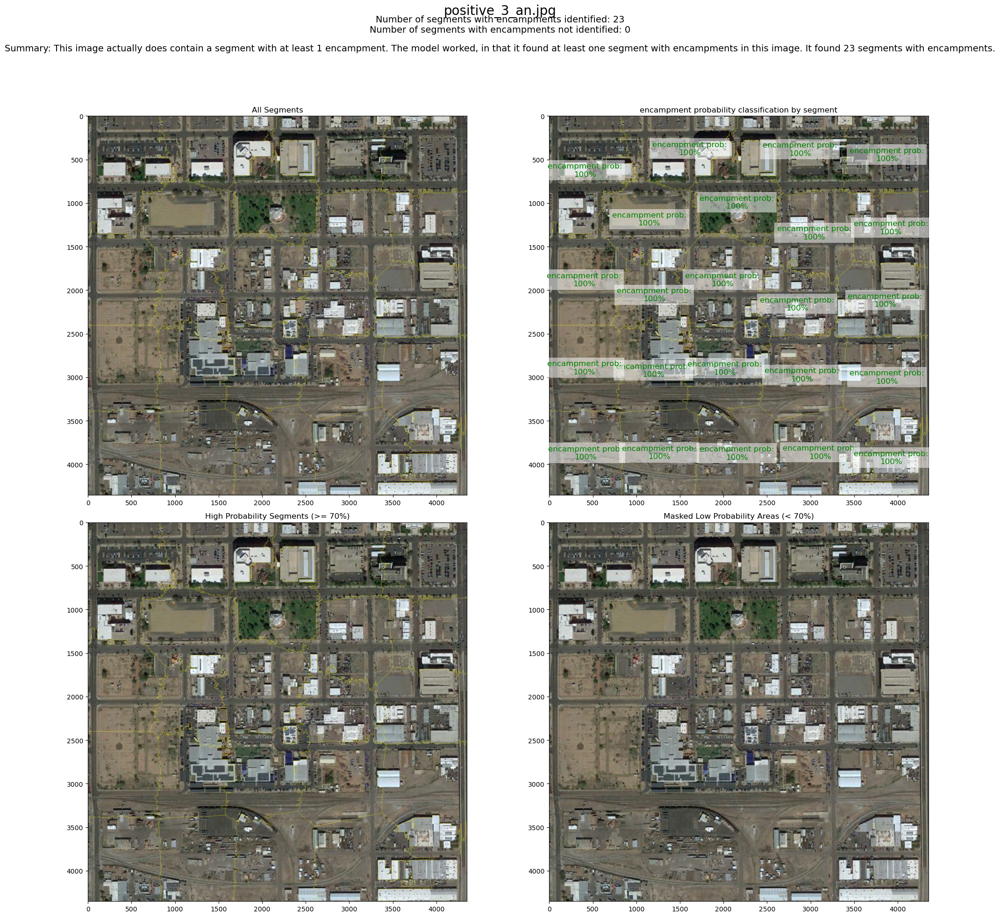

Number of segments: 22
Number of labels: 22


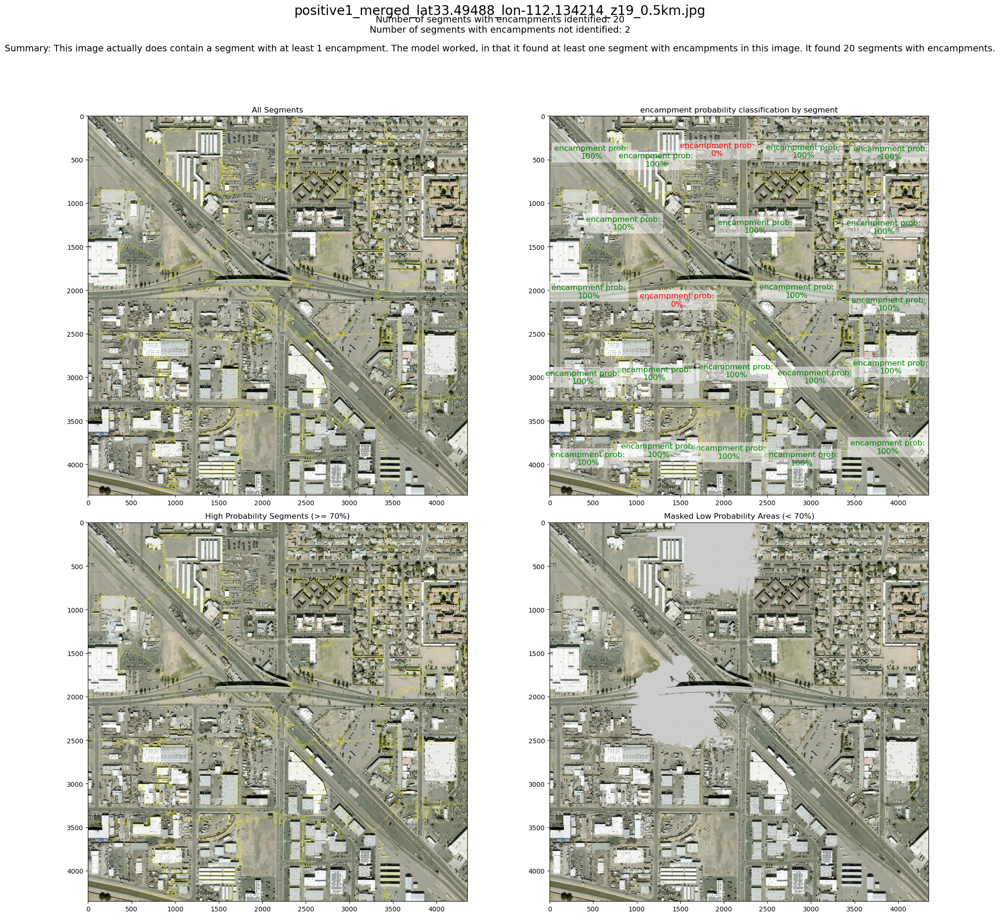

Number of segments: 24
Number of labels: 24


In [ ]:
###
# Define Helper Functions to Process Image
###


# Function to create segments from each example tile image @name
def slic_segments(name):
    img = img_as_float(io.imread(name))
    return slic(img, n_segments=30, compactness=35, sigma=1)

# Function to prepare each segment for classification
def prepare_segment(segment_info, parent_image_object, target_size=(224, 224)):
    width_height_tuple = (target_size[1], target_size[0])
    y0, x0, y1, x1 = segment_info.bbox
    segment_size = (y1 - y0, x1 - x0)
    
    cropped = parent_image_object.crop((x0, y0, x1, y1))
        
    if segment_size != width_height_tuple:
        resample = Image.NEAREST
        cropped = cropped.resize(width_height_tuple, resample)
        
    return cropped

# Function to extract features for each segment/superpixel from image, using Resnet
def features_from_tile(img_name, resnet, batch_size=64):
    segments = [] 
    # Get geometry info about each segment
    segments_info = regionprops(slic_segments(img_name))      
    image_object = Image.open(img_name)
    
    n = len(segments_info)
    img_array = np.zeros((n, 224, 224, 3))
    
    for i, s in enumerate(segments_info):
        img = prepare_segment(s, image_object)
        img = image.img_to_array(img)
        img = preprocess_input(img)
        img_array[i] = img
    
    # Predict features using ResNet
    X = resnet.predict(img_array, batch_size=batch_size, verbose=0)
    return X

# Split to segments, get features, classify segment, return labels for each segment        
def search_in_tile(img_name, classifier, resnet, occurences_treshold=0):
    features = features_from_tile(img_name, resnet)
    features_array = np.array(features)  # Convert features to NumPy array

    #dmatrix_features = xgb.DMatrix(features)  # Convert features to DMatrix
    #Y_pred = classifier.predict(dmatrix_features)
    Y_pred = classifier.predict(features_array)
    labels = Y_pred.tolist()
    
    if labels.count("positive") > occurences_treshold:
        print("encampment detected!")
    return labels

# Load ResNet model (takes some time)
resnet = ResNet50(weights='imagenet', include_top=False, pooling='avg')

# Example usage
#img_name = "./model/datasets/example/positive3.png"
#labels = search_in_tile(img_name, clf, resnet)

# Define the folder path
folder_path = "./model/datasets/example"

# Get a list of all files in the folder
all_files = os.listdir(folder_path)

# Filter out the image files based on their extensions
image_extensions = ['.png', '.jpg', '.jpeg']  # Add more extensions if needed
file_list = [file for file in all_files if os.path.splitext(file)[1].lower() in image_extensions]

# Prepend the folder path to each file name
file_list = [os.path.join(folder_path, file) for file in file_list]


# Function to process each image
def process_image(img_name, clf, resnet):
    # Construct labels using search_in_tile
    labels = search_in_tile(img_name, clf, resnet)

    # Read and preprocess the image
    img = io.imread(img_name)  # image as numpy array
    original_image = Image.fromarray(img.astype('uint8'), 'RGB')  # same image as PIL object
    img = img_as_float(img)  # convert to float, to use for segmentation purposes

    # Split image into segments
    segments_slic = slic(img, n_segments=30, compactness=35, sigma=1)  # split image to segments
    marked_img_all = mark_boundaries(img, segments_slic)  # image with all segments and boundaries

    # Find label values for each segment without encampments
    negative_labels = [i + 1 for i, l in enumerate(labels) if l == 0]  # assuming 0 is negative

    # Create a copy of segments_slic for positive segments
    segments_slic_positive = segments_slic.copy()

    # Filter out from our mask all pixels with values for "negative" segments
    segments_slic_positive[np.isin(segments_slic_positive, negative_labels)] = 0

    # Mark boundaries for positive segments
    marked_img_positive = mark_boundaries(img, segments_slic_positive)  # new image has only boundaries for positive segments

    # Show images in a 2x2 grid
    fig, ((ax0, ax1), (ax2, ax3)) = plt.subplots(nrows=2, ncols=2, figsize=(20, 20))
    filename = os.path.basename(img_name)
    fig.suptitle(f"{filename}", fontsize=20)  # Add the image name as a title above the plots

    ax0.imshow(marked_img_all)
    ax0.set_title("All Segments")
    ax1.imshow(marked_img_positive)
    ax1.set_title("encampment probability classification by segment")

    # Debugging information
    segments_info = regionprops(segments_slic)
    print(f"Number of segments: {len(segments_info)}")
    print(f"Number of labels: {len(labels)}")

    # Ensure the number of labels matches the number of segments
    if len(labels) < len(segments_info):
        labels.extend([-1] * (len(segments_info) - len(labels)))  # Add placeholder labels for missing segments

    # Create a mask for segments with encampment probability >= 70%
    segments_slic_high_prob = segments_slic.copy()
    high_prob_count = 0
    low_prob_count = 0
    for i, segment in enumerate(segments_info):
        label = labels[i]
        centroid = segment.centroid
        # Multiply by 100, round to 1 decimal place, and add percentage and text
        percentage = round(label * 100, 1)
        label_text = f"encampment prob:\n{percentage}%"
        # Set color based on percentage
        color = 'green' if percentage >= 70 else 'red'
        ax1.text(centroid[1], centroid[0], label_text, color=color, fontsize=12, ha='center', va='center', bbox=dict(facecolor='white', alpha=0.5, edgecolor='none'))
        # Filter out segments with probability < 70%
        if percentage >= 70:
            high_prob_count += 1
        else:
            low_prob_count += 1
            segments_slic_high_prob[segments_slic == (i + 1)] = 0

    # Mark boundaries for high probability segments
    marked_img_high_prob = mark_boundaries(img, segments_slic_high_prob)
    ax2.imshow(marked_img_high_prob)
    ax2.set_title("High Probability Segments (>= 70%)")

    # Mask areas below 70% with solid light grey
    masked_img = img.copy()
    masked_img[segments_slic_high_prob == 0] = [0.8, 0.8, 0.8]  # light grey color
    ax3.imshow(masked_img)
    ax3.set_title("Masked Low Probability Areas (< 70%)")

    # Add subheading with counts
    fig.text(0.5, 0.95, f"Number of segments with encampments identified: {high_prob_count}\nNumber of segments with encampments not identified: {low_prob_count}", ha='center', fontsize=14)

    # Add summary based on filename
    if "negative" in filename.lower():
        if high_prob_count == 0:
            summary = "This image actually does not contain any encampments. The model correctly identified 0 segments with encampments."
        else:
            summary = f"This image actually does not contain any encampments. The model incorrectly identified {high_prob_count} segments with encampments."
    elif "positive" in filename.lower():
        if high_prob_count > 0:
            summary = f"This image actually does contain a segment with at least 1 encampment. The model worked, in that it found at least one segment with encampments in this image. It found {high_prob_count} segments with encampments."
        else:
            summary = "This image actually does contain a segment with at least 1 encampment. The model incorrectly predicted that there are no segments with encampments in this picture."
    else:
        summary = ""

    fig.text(0.5, 0.93, f"Summary: {summary}", ha='center', fontsize=14)

    fig.tight_layout(rect=[0, 0, 1, 0.90])  # Adjust layout to make room for the title and subheading
    plt.show()

# Loop through the file_list and process each image
for file in file_list:
    process_image(file, clf, resnet)

We re-ran this code again after adding in augmented positives -- looks like that actually really deteriorated our results. Our model is still thinking everything is an encampment. Before, we had a lot of false positives in this last test, but certainly not 100 percent.